In [1]:
%load_ext autoreload
%autoreload 2

import pymc as pm
import seaborn as sns
import pandas as pd
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import numpy as np
import arviz as az
from matplotlib import pyplot as plt

import sys
sys.path.append('..')
from pfas_prep import PFAS
from PyPKMC import PyPKMC
import register_pfas_data as rpd

In [2]:
chemical = 'PFHxA'
pfas_db = '../PFAS.db'
pfas_tmp = PFAS(pfas_db, pfas_file = '../auxiliary/pfas_master.csv')
Vdss_prior = {'mu': -1.5, 'sd': 1.5}
CLC_prior = {'mu': -2.89, 'sd': 2.68}
load_trace = True

# Rat fits

## Male

First import the data using the old PFAS class

In [3]:
%%time
pfas_male_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='rat')
pfas_male_data.head()

Hero ID available:  [2850314 2850396 3859701 5916078 6822782]
dropping duplicated column
Hero ID used:  [2850314 2850396 3859701 5916078]
CPU times: user 600 ms, sys: 4.96 ms, total: 605 ms
Wall time: 606 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2850314,1,-1,4,-1.0,NaN,0.17037,NaN,rat,sprague-dawley,2.0,mg/kg,0.25,hour,5.114025,1.198559,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,7,0,0,0,0.010417,2.0,42.010417,0.170370,5.114025,1.198559,0.0,-1,0,1,0,0.231241,1.605251,0.234367,False,0.340739,2850314-2.0 mg/kg-gavage
1,2850314,1,-1,4,-1.0,NaN,0.17037,NaN,rat,sprague-dawley,2.0,mg/kg,0.50,hour,5.792774,3.088057,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,7,0,0,0,0.020833,2.0,42.020833,0.170439,5.792774,3.088057,0.0,-1,0,1,0,0.500122,1.631550,0.533088,False,0.340739,2850314-2.0 mg/kg-gavage
2,2850314,1,-1,4,-1.0,NaN,0.17037,NaN,rat,sprague-dawley,2.0,mg/kg,1.00,hour,5.590140,1.089334,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,7,0,0,0,0.041667,2.0,42.041667,0.170579,5.590140,1.089334,0.0,-1,0,1,0,0.193054,1.702369,0.194867,False,0.340739,2850314-2.0 mg/kg-gavage
3,2850314,1,-1,4,-1.0,NaN,0.17037,NaN,rat,sprague-dawley,2.0,mg/kg,2.00,hour,2.841896,0.676881,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,7,0,0,0,0.083333,2.0,42.083333,0.170857,2.841896,0.676881,0.0,-1,0,1,0,0.234901,1.016882,0.238179,False,0.340739,2850314-2.0 mg/kg-gavage
4,2850314,1,-1,4,-1.0,NaN,0.17037,NaN,rat,sprague-dawley,2.0,mg/kg,4.00,hour,0.846906,0.095476,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,7,0,0,0,0.166667,2.0,42.166667,0.171414,0.846906,0.095476,0.0,-1,0,1,0,0.112379,-0.172480,0.112735,False,0.340739,2850314-2.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [4]:
pfas_male_1cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Male_rat_1cmpt
hierarchical model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


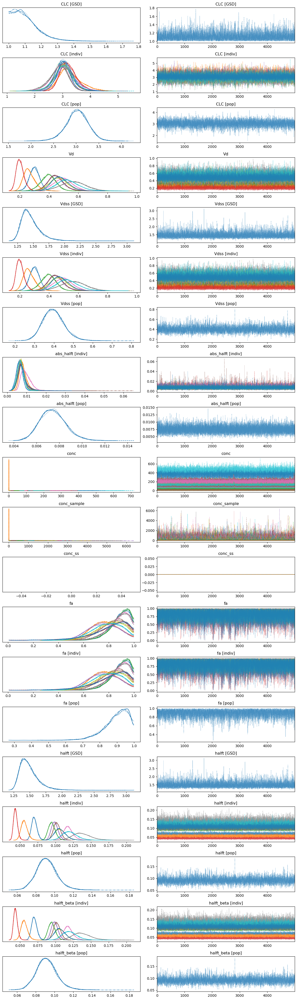

In [5]:
with pfas_male_1cmpt.model:
    az.plot_trace(pfas_male_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


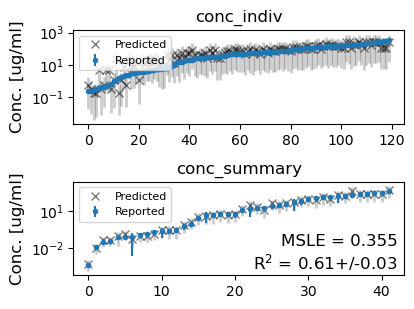

In [6]:
pfas_male_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [7]:
pfas_male_2cmpt = PyPKMC(pfas_male_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx', #Rkcd_SD_prior = 2,
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   #load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)
                       load_trace=load_trace, tune=5000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Male_rat_2cmpt
hierarchical model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


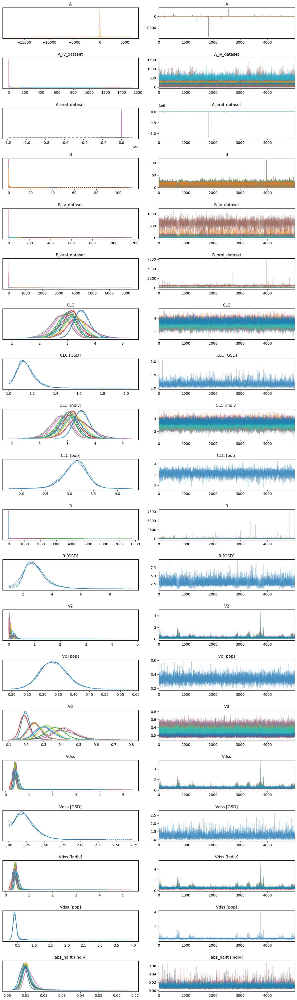

In [8]:
with pfas_male_2cmpt.model: # orig prior
    az.plot_trace(pfas_male_2cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


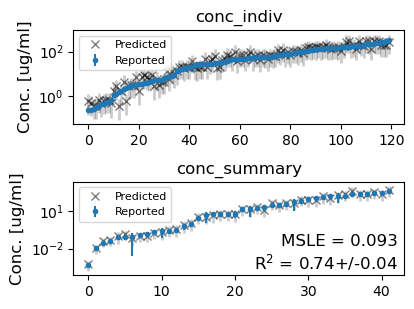

In [9]:
pfas_male_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-794.344997,45.495211,0.000000,0.976645,70.867937,0.000000,True,log
1_compartment,1,-871.990154,37.893141,77.645157,0.023355,69.886729,12.896775,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

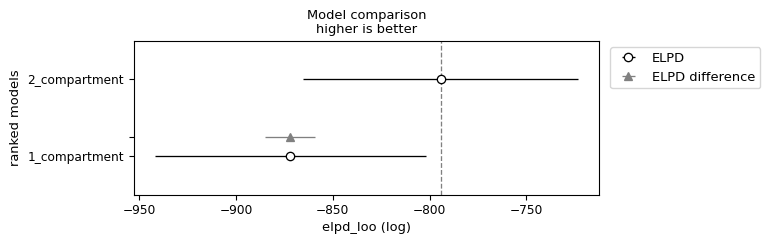

In [10]:
pfas_male_compare = az.compare({"1_compartment": pfas_male_1cmpt._trace, "2_compartment": pfas_male_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_male_compare)
az.plot_compare(pfas_male_compare, insample_dev=False)

#### Define winning model

In [11]:
pfas_male = pfas_male_2cmpt
print(pfas_male.N_divergences)
print(f'Pass all metrics = {pfas_male.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


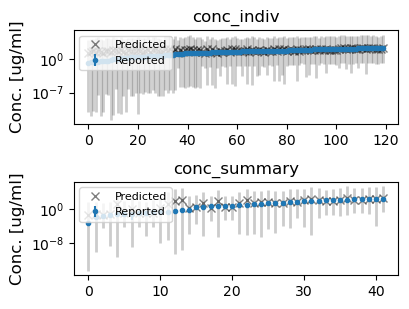

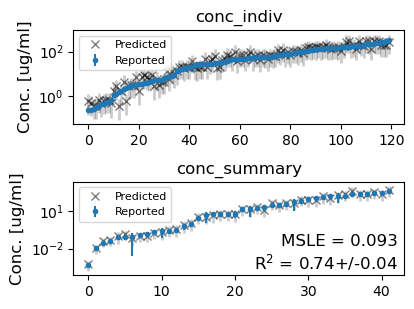

In [12]:
pfas_male.plot_data_ppc(group='prior', savefig=True)
pfas_male.plot_data_ppc(group='posterior', savefig=True)

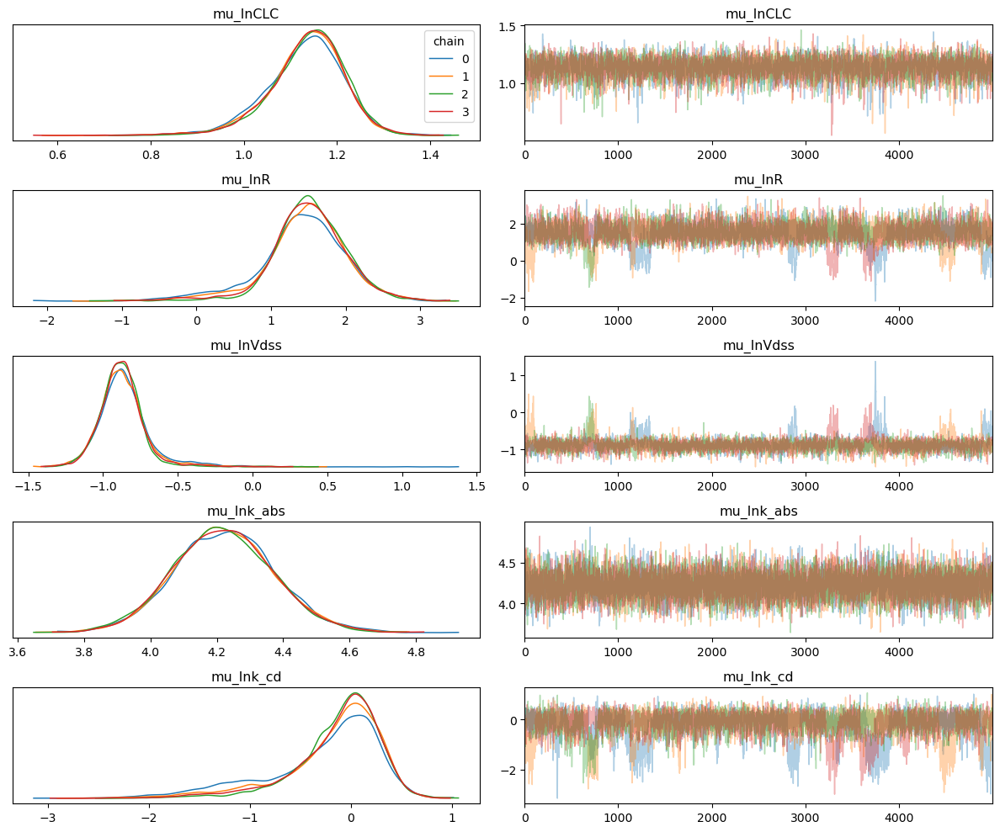

In [13]:
trace_model = pfas_male
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFHxA/PFHxA_Male_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


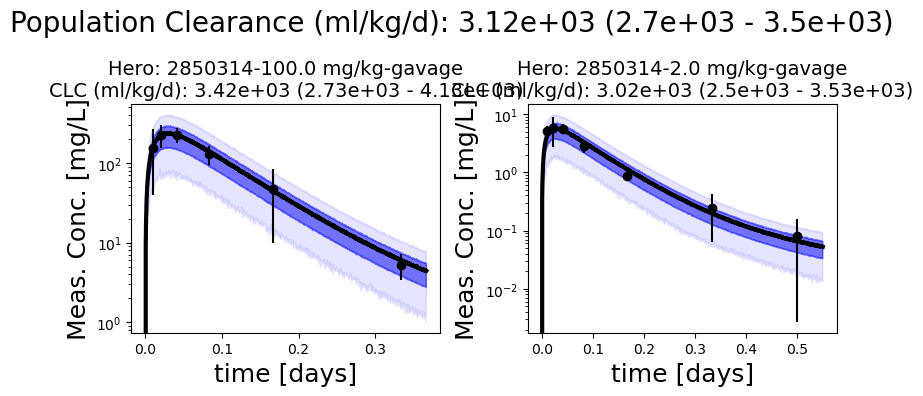

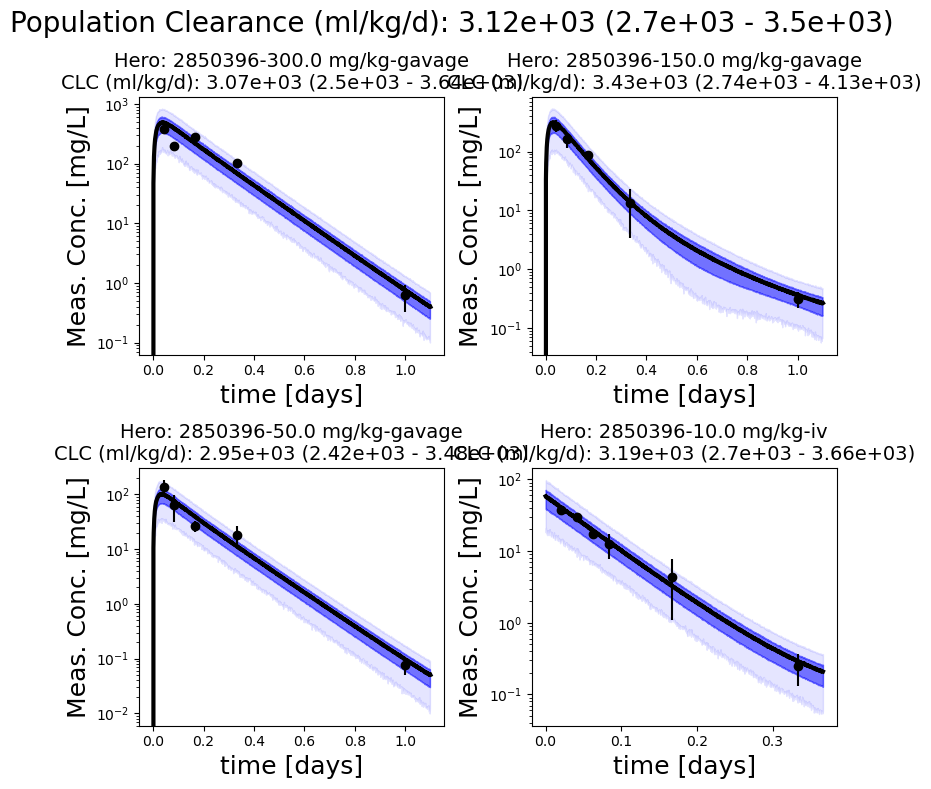

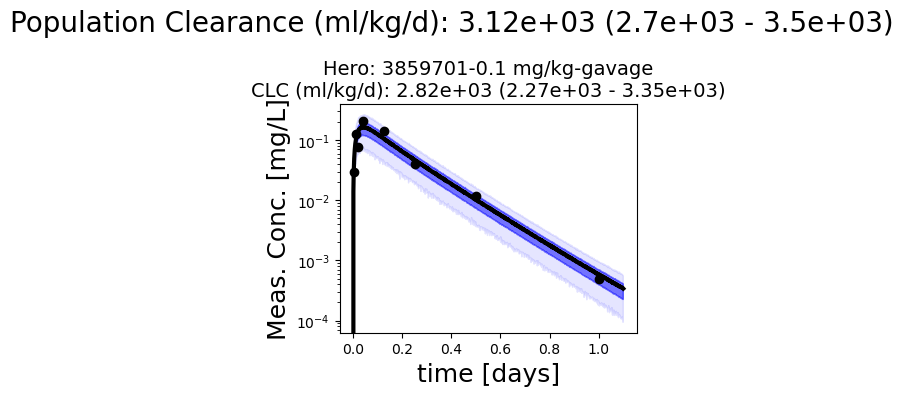

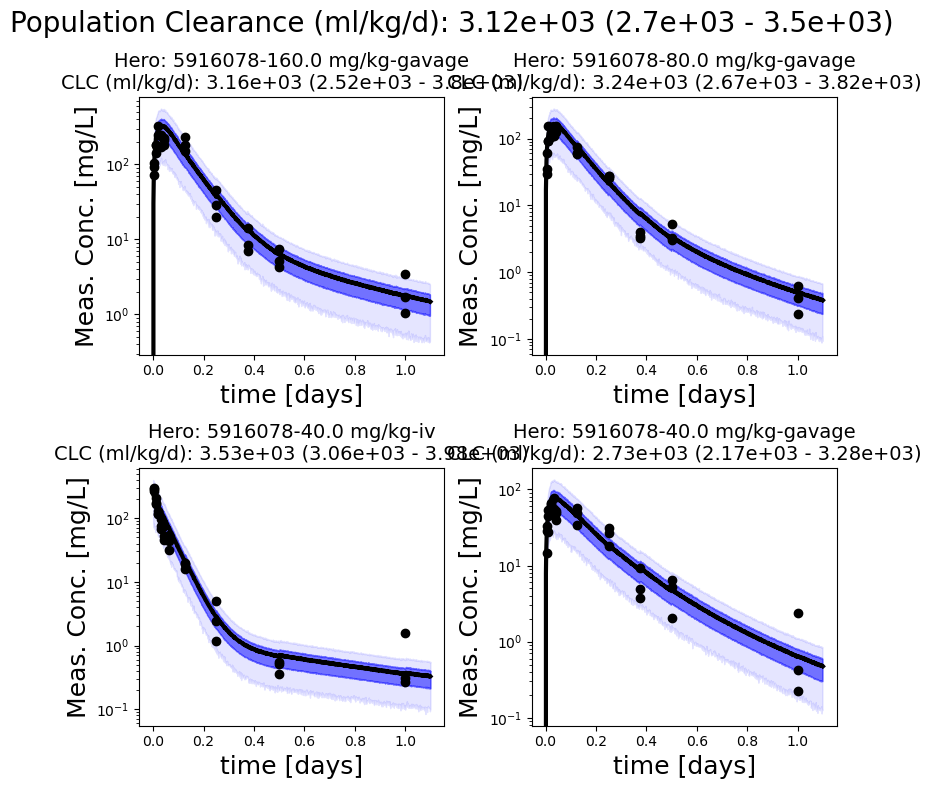

In [14]:
pfas_male.plot_all_studies()

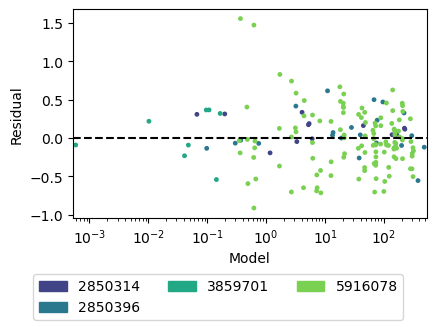

In [15]:
pfas_male.plot_residuals()

### PK stats

In [16]:
pfas_male.get_pk_stats() 

,mean,sd,hdi_5%,hdi_95%
CLC [pop],3.11809,0.24859,2.70359,3.50278
Vc [pop],0.33560,0.04475,0.26284,0.40795
Vdss [pop],0.42638,0.09778,0.31796,0.51129
abs_halft [pop],0.01030,0.00155,0.00779,0.01279
fa [pop],0.91057,0.06465,0.82140,0.99912
halft [pop],0.09507,0.02235,0.07188,0.11150
halft_alpha [pop],0.06236,0.00901,0.04825,0.07712
halft_beta [pop],0.37294,0.80447,0.07657,0.52315


## Female

In [17]:
%%time
pfas_female_data = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='rat')
#pfas_female_data = pfas_female_data[pfas_female_data.dose < 300]
pfas_female_data.head()

Hero ID available:  [2850314 2850396 3859701 5916078 6822782]
dropping duplicated column
Hero ID used:  [2850314 2850396 5916078]
CPU times: user 532 ms, sys: 4.92 ms, total: 537 ms
Wall time: 537 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,time_course,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2850314,2,-1,4,-1.0,NaN,0.146333,NaN,rat,sprague-dawley,2.0,mg/kg,0.25,hour,5.590140,2.980035,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,5,0,0,0,0.010417,2.0,42.010417,0.146333,5.590140,2.980035,0.0,-1,0,1,1,0.500122,1.595943,0.533088,False,0.292667,2850314-2.0 mg/kg-gavage
1,2850314,2,-1,4,-1.0,NaN,0.146333,NaN,rat,sprague-dawley,2.0,mg/kg,0.50,hour,4.204471,1.362574,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,5,0,0,0,0.020833,2.0,42.020833,0.146367,4.204471,1.362574,0.0,-1,0,1,1,0.316021,1.386214,0.324077,False,0.292667,2850314-2.0 mg/kg-gavage
2,2850314,2,-1,4,-1.0,NaN,0.146333,NaN,rat,sprague-dawley,2.0,mg/kg,1.00,hour,1.887006,0.621901,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,5,0,0,0,0.041667,2.0,42.041667,0.146434,1.887006,0.621901,0.0,-1,0,1,1,0.321112,0.583435,0.329570,False,0.292667,2850314-2.0 mg/kg-gavage
3,2850314,2,-1,4,-1.0,NaN,0.146333,NaN,rat,sprague-dawley,2.0,mg/kg,2.00,hour,0.360331,0.163357,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,5,0,0,0,0.083333,2.0,42.083333,0.146568,0.360331,0.163357,0.0,-1,0,1,1,0.432341,-1.114193,0.453353,False,0.292667,2850314-2.0 mg/kg-gavage
4,2850314,2,-1,4,-1.0,NaN,0.146333,NaN,rat,sprague-dawley,2.0,mg/kg,4.00,hour,0.059672,0.053600,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 1,6.0,weeks,NaN,Not Reported,4,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,5,0,0,0,0.166667,2.0,42.166667,0.146836,0.059672,0.053600,0.0,-1,0,1,1,0.769139,-3.114673,0.898237,False,0.292667,2850314-2.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [18]:
pfas_female_1cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=10000, draws=10000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Female_rat_1cmpt
hierarchical model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (45), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


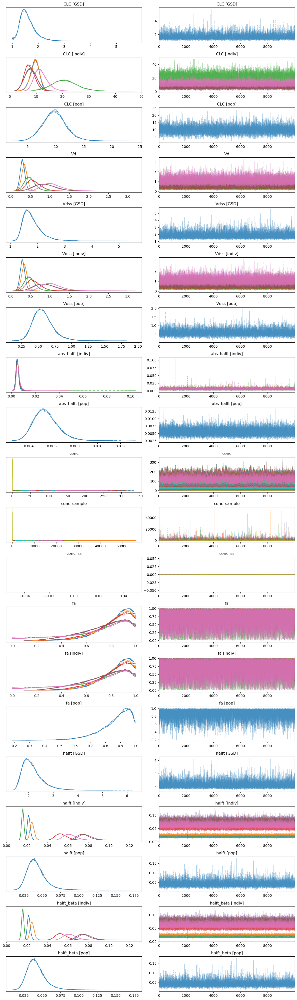

In [19]:
with pfas_female_1cmpt.model:
    az.plot_trace(pfas_female_1cmpt._trace)
    plt.tight_layout()

conc_indiv
conc_summary


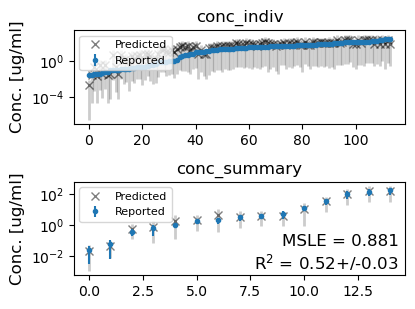

In [20]:
pfas_female_1cmpt.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [21]:
pfas_female_2cmpt = PyPKMC(pfas_female_data, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, 
                           Vdss_prior = Vdss_prior
                           #Vdss_prior = {'mu': -1.3862, 'sd':0.405465}
                          )
pfas_female_2cmpt.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                   load_trace=load_trace, tune=5000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)
                   #load_trace=False, tune=2000, draws=2000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Female_rat_2cmpt
hierarchical model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


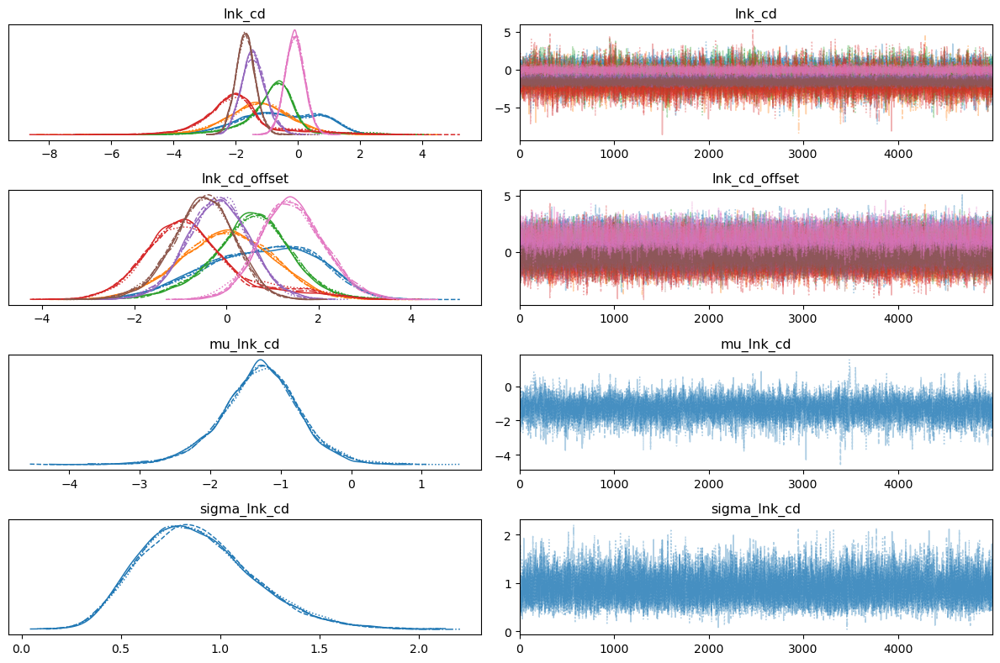

In [22]:
with pfas_female_2cmpt.model:
    az.plot_trace(pfas_female_2cmpt._trace, var_names=['^mu_lnk_cd', '^lnk_cd', '^sigma_lnk_cd'], filter_vars='regex')
    plt.tight_layout()

conc_indiv
conc_summary


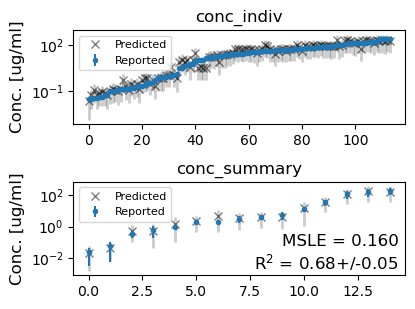

In [23]:
pfas_female_2cmpt.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:1024: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal poster

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-472.709707,25.311846,0.000000,0.985161,49.289244,0.000000,True,log
1_compartment,1,-567.601248,25.623079,94.891541,0.014839,46.769626,15.037722,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

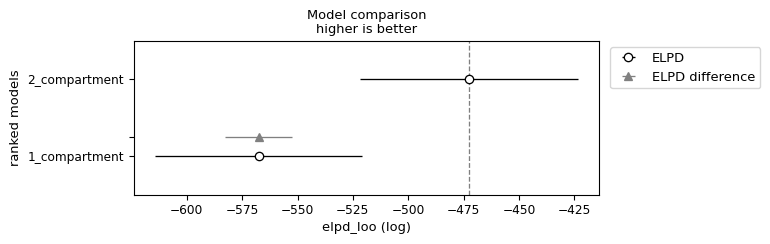

In [24]:
pfas_female_compare = az.compare({"1_compartment": pfas_female_1cmpt._trace, "2_compartment": pfas_female_2cmpt._trace},
                           var_name="combined",ic='loo')
display(pfas_female_compare)
az.plot_compare(pfas_female_compare, insample_dev=False)

#### Define winning model

In [25]:
pfas_female = pfas_female_2cmpt
print(pfas_female.N_divergences)
print(f'Pass all metrics = {pfas_female.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


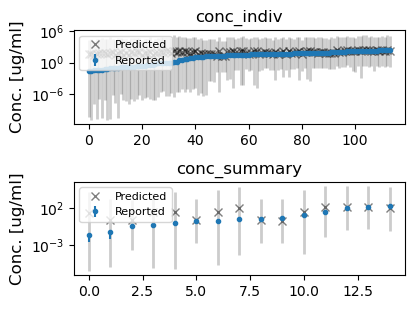

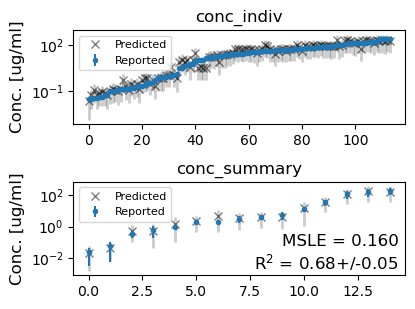

In [26]:
pfas_female.plot_data_ppc(group='prior', savefig=True)
pfas_female.plot_data_ppc(group='posterior', savefig=True)

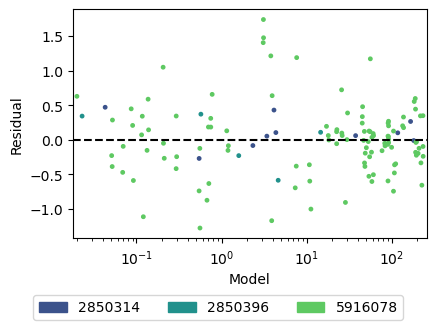

In [27]:
pfas_female.plot_residuals() 

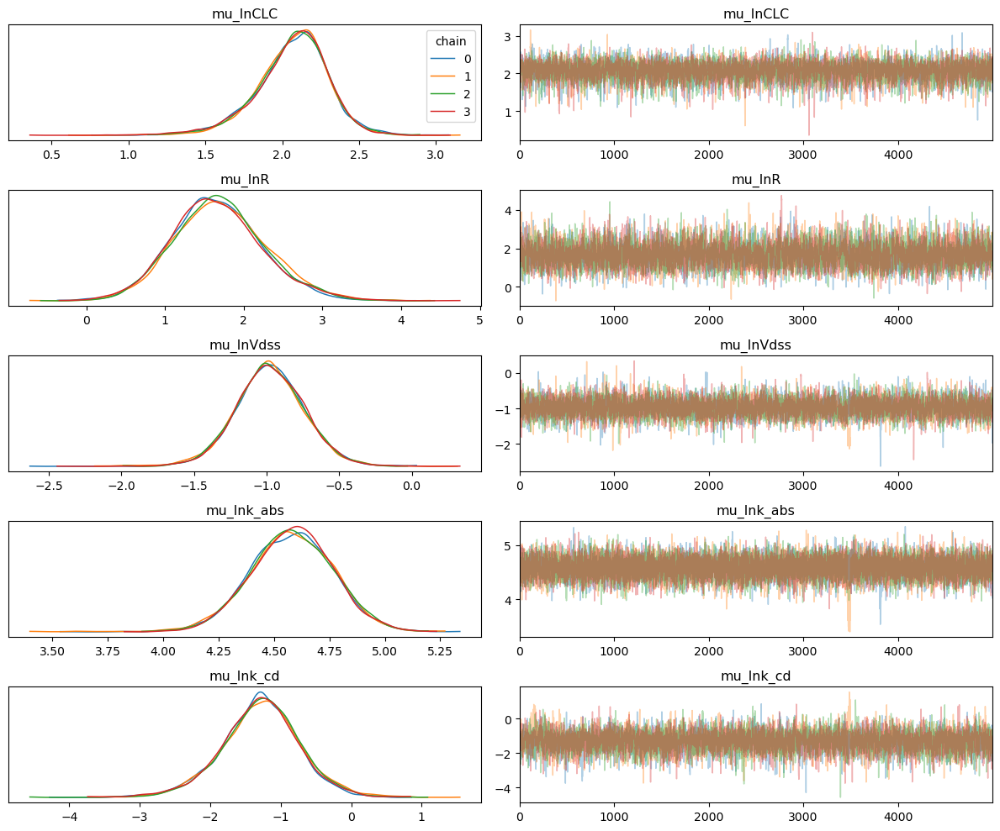

In [28]:
trace_model = pfas_female
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/rat/PFHxA/PFHxA_Female_rat_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


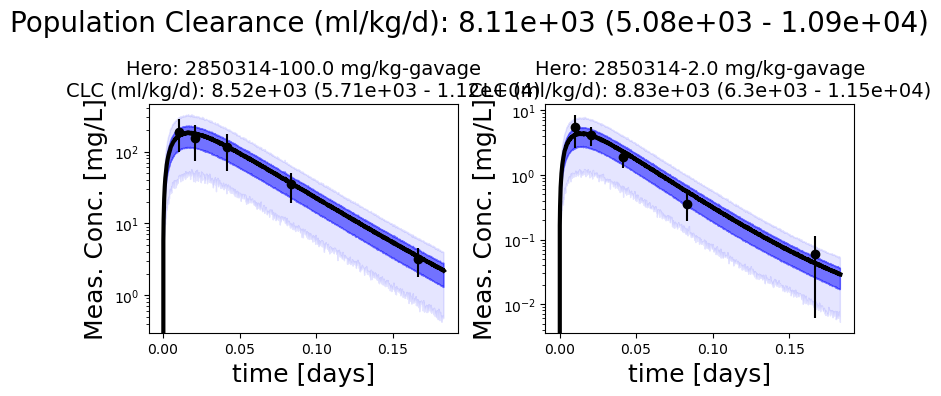

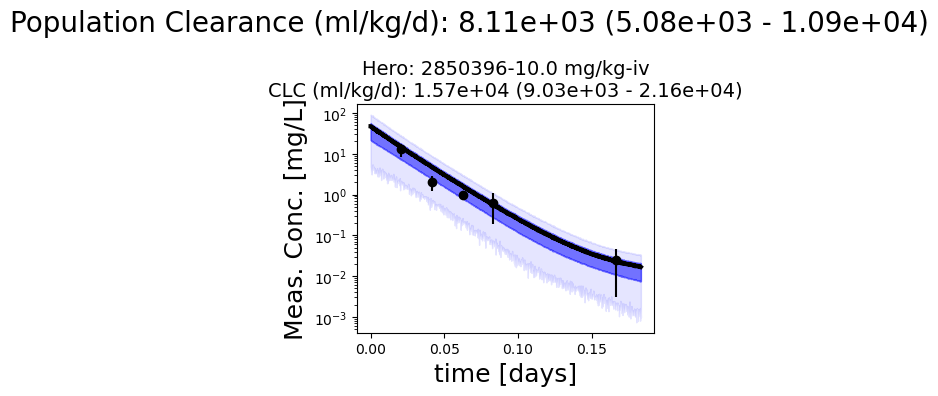

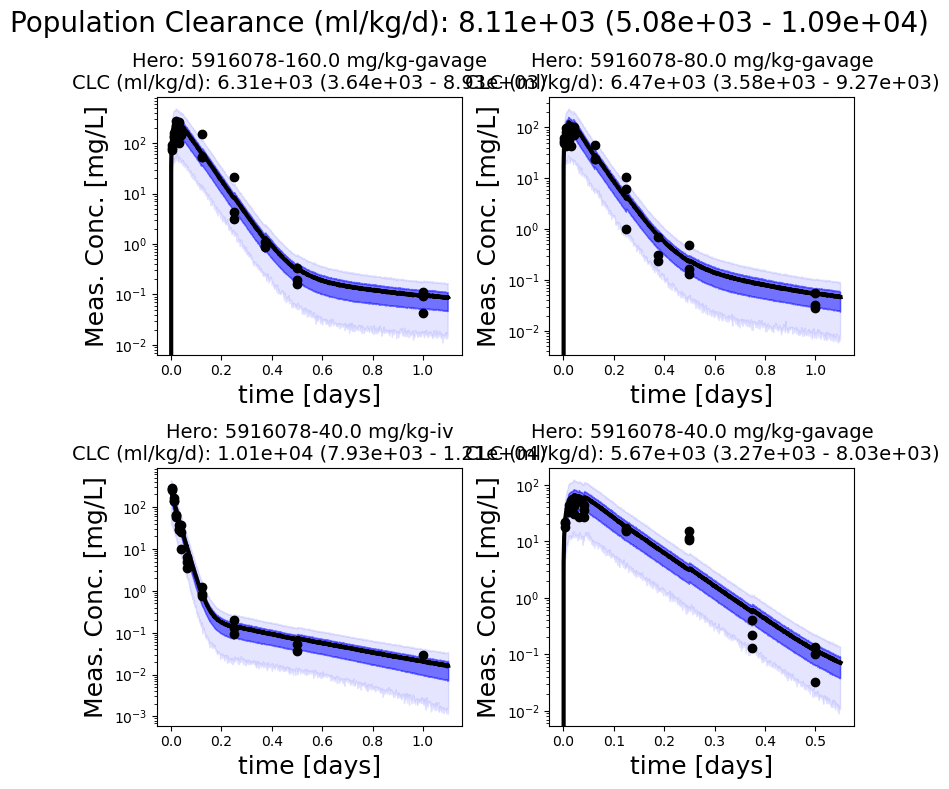

In [29]:
pfas_female.plot_all_studies()

### PK stats

In [30]:
pfas_female.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],8.11479,1.82560,5.08308,10.87993
Vc [pop],0.31831,0.07089,0.20571,0.42802
Vdss [pop],0.38779,0.09600,0.23901,0.53186
abs_halft [pop],0.00724,0.00141,0.00501,0.00933
fa [pop],0.83601,0.11772,0.67065,0.99782
halft [pop],0.03420,0.00950,0.02007,0.04810
halft_alpha [pop],0.02764,0.00695,0.01679,0.03778
halft_beta [pop],0.64984,0.63214,0.03735,1.25386


# Mouse

## Male

In [31]:
%%time
pfas_male_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='mouse')
pfas_male_data_mouse.head()

Hero ID available:  [2850314 2850396 3859701 5916078 6822782]
dropping duplicated column
Hero ID used:  [2850314]
CPU times: user 64.3 ms, sys: 4.99 ms, total: 69.2 ms
Wall time: 68.5 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2850314,3,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,0.25,hour,7.777629,2.281253,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,9,0,0,0,0.010417,2.0,0.03,7.777629,2.281253,0.0,-1,0,1,0,0.287279,2.009987,0.293310,False,0.06,2850314-2.0 mg/kg-gavage
1,2850314,3,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,0.50,hour,6.238538,0.855846,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,9,0,0,0,0.020833,2.0,0.03,6.238538,0.855846,0.0,-1,0,1,0,0.136548,1.821423,0.137187,False,0.06,2850314-2.0 mg/kg-gavage
2,2850314,3,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,2.00,hour,4.163822,0.317510,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,9,0,0,0,0.083333,2.0,0.03,4.163822,0.317510,0.0,-1,0,1,0,0.076144,1.423535,0.076255,False,0.06,2850314-2.0 mg/kg-gavage
3,2850314,3,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,4.00,hour,1.601402,0.980548,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,9,0,0,0,0.166667,2.0,0.03,1.601402,0.980548,0.0,-1,0,1,0,0.564265,0.311682,0.612306,False,0.06,2850314-2.0 mg/kg-gavage
4,2850314,3,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,8.00,hour,0.259669,0.225282,0,ug/ml,gavage,plasma,Male,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,9,0,0,0,0.333333,2.0,0.03,0.259669,0.225282,0.0,-1,0,1,0,0.749098,-1.628922,0.867573,False,0.06,2850314-2.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [32]:
pfas_male_1cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=12000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Male_mouse_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


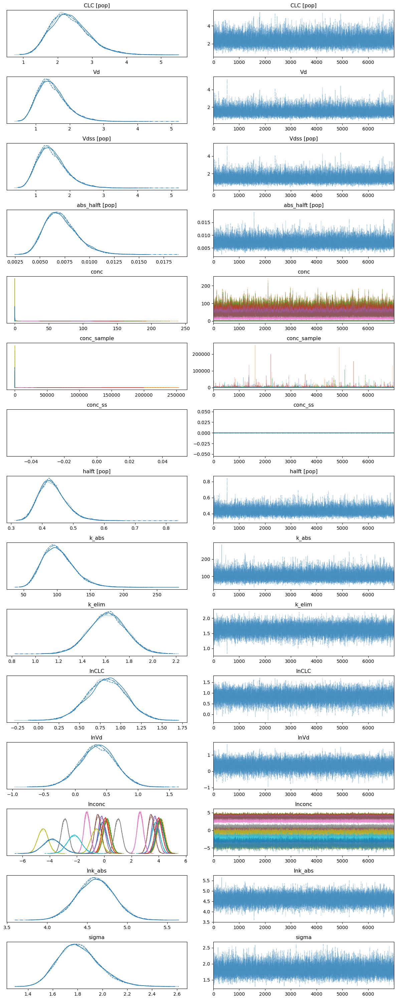

In [33]:
with pfas_male_1cmpt_mouse.model:
    az.plot_trace(pfas_male_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


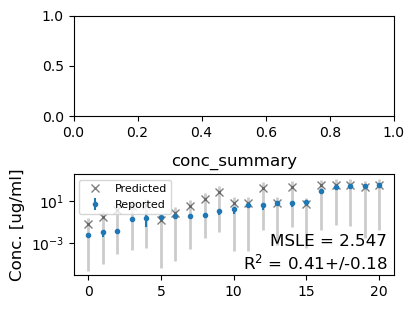

In [34]:
pfas_male_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [35]:
pfas_male_2cmpt_mouse = PyPKMC(pfas_male_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=7000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Male_mouse_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


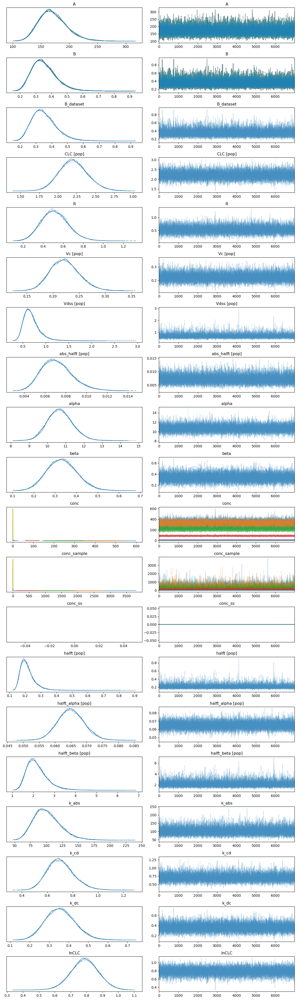

In [36]:
with pfas_male_2cmpt_mouse.model:
    az.plot_trace(pfas_male_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


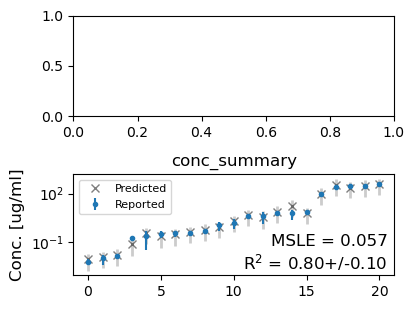

In [37]:
pfas_male_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-97.562746,13.065397,0.000000,0.91521,44.843936,0.000000,True,log
1_compartment,1,-173.919410,7.543925,76.356664,0.08479,44.687274,13.377023,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

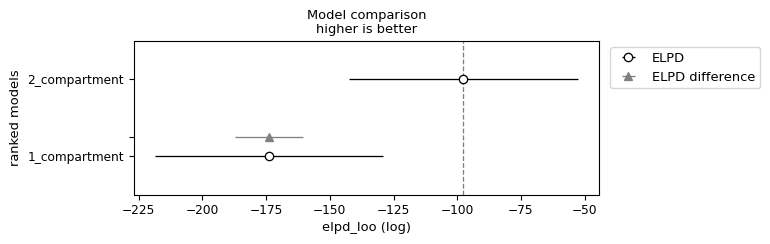

In [38]:
pfas_male_mouse_compare = az.compare({"1_compartment": pfas_male_1cmpt_mouse._trace, "2_compartment": pfas_male_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_male_mouse_compare)
az.plot_compare(pfas_male_mouse_compare, insample_dev=False)

 #### Define winning model

In [39]:
pfas_male_mouse = pfas_male_2cmpt_mouse
print(pfas_male_mouse.N_divergences)
print(f'Pass all metrics = {pfas_male_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


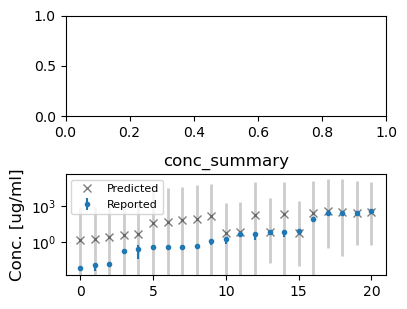

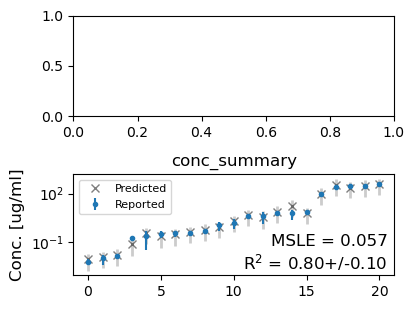

In [40]:
pfas_male_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_male_mouse.plot_data_ppc(group='posterior', savefig=True)

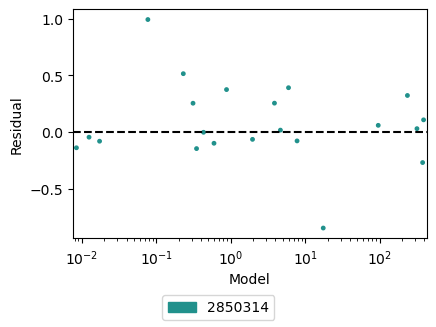

In [41]:
pfas_male_mouse.plot_residuals() 

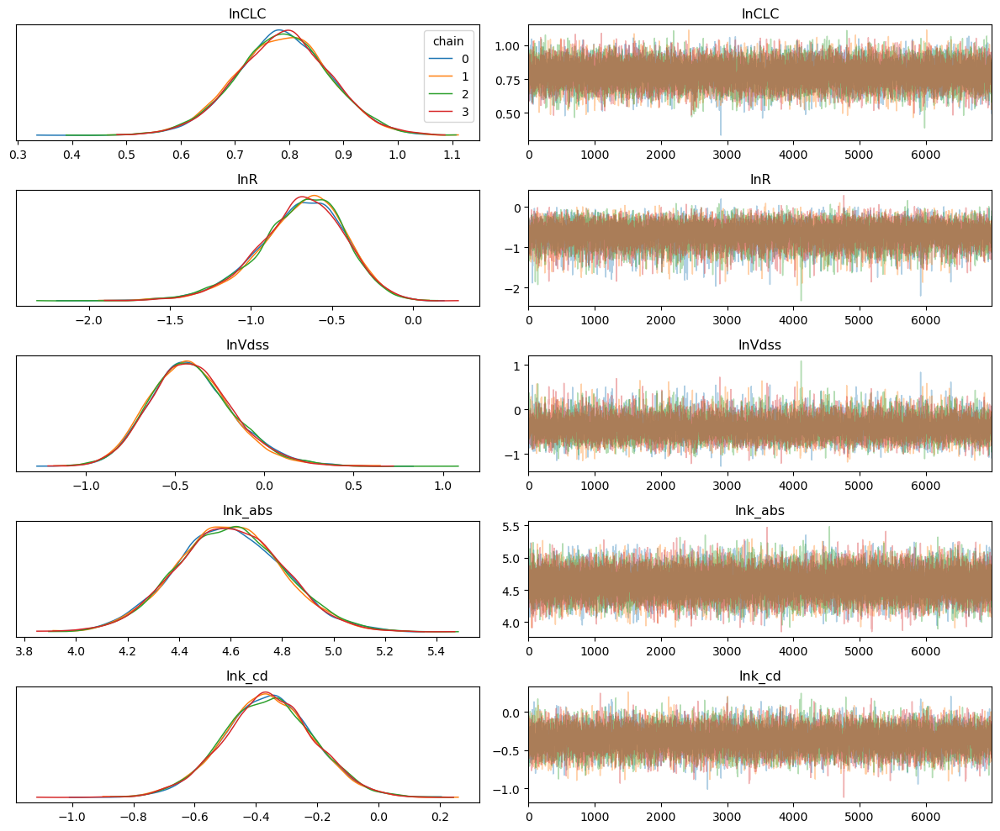

In [42]:
trace_model = pfas_male_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFHxA/PFHxA_Male_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


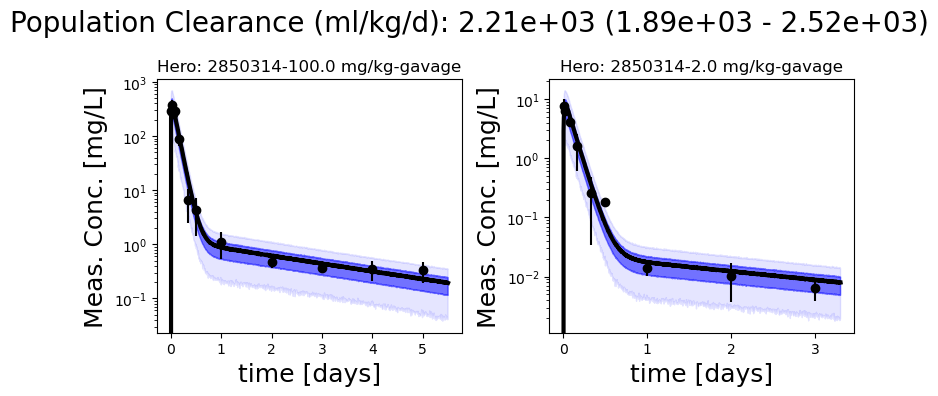

In [43]:
pfas_male_mouse.plot_all_studies()

### PK stats

In [44]:
pfas_male_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],2.20669,0.19177,1.89081,2.51771
Vc [pop],0.22268,0.02827,0.17622,0.26800
Vdss [pop],0.68688,0.17648,0.42794,0.94141
abs_halft [pop],0.00715,0.00148,0.00476,0.00951
halft [pop],0.21492,0.04832,0.14689,0.28123
halft_alpha [pop],0.06503,0.00420,0.05832,0.07202
halft_beta [pop],2.17924,0.50237,1.40889,2.89282


## Female

In [45]:
%%time
pfas_female_data_mouse = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='mouse')
pfas_female_data_mouse.head()

Hero ID available:  [2850314 2850396 3859701 5916078 6822782]
dropping duplicated column
Hero ID used:  [2850314 6822782]
CPU times: user 81.6 ms, sys: 984 μs, total: 82.6 ms
Wall time: 81.9 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2850314,4,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,0.25,hour,7.921838,2.137268,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,8,0,0,0,0.010417,2.0,0.03,7.921838,2.137268,0.0,-1,0,1,1,0.265070,2.034492,0.269794,False,0.06,2850314-2.0 mg/kg-gavage
1,2850314,4,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,0.50,hour,5.691134,1.676811,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,8,0,0,0,0.020833,2.0,0.03,5.691134,1.676811,0.0,-1,0,1,1,0.288526,1.697286,0.294636,False,0.06,2850314-2.0 mg/kg-gavage
2,2850314,4,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,1.00,hour,1.997103,0.152192,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,8,0,0,0,0.041667,2.0,0.03,1.997103,0.152192,0.0,-1,0,1,1,0.076096,0.688802,0.076206,False,0.06,2850314-2.0 mg/kg-gavage
3,2850314,4,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,2.00,hour,0.889749,0.122130,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,8,0,0,0,0.083333,2.0,0.03,0.889749,0.122130,0.0,-1,0,1,1,0.136623,-0.126149,0.137263,False,0.06,2850314-2.0 mg/kg-gavage
4,2850314,4,-1,3,-1.0,NaN,0.03,NaN,mouse,CD-1,2.0,mg/kg,4.00,hour,0.111581,0.024986,0,ug/ml,gavage,plasma,Female,DTXSID3031862,Figure 2,6.0,weeks,30.0,grams,3,Gannon,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,8,0,0,0,0.166667,2.0,0.03,0.111581,0.024986,0.0,-1,0,1,1,0.221196,-2.217466,0.223930,False,0.06,2850314-2.0 mg/kg-gavage


### Run the models

#### 1-Compartment model

In [46]:
pfas_female_1cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_mouse.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro', random_seed=98765,
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Female_mouse_1cmpt
hierarchical model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (39), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


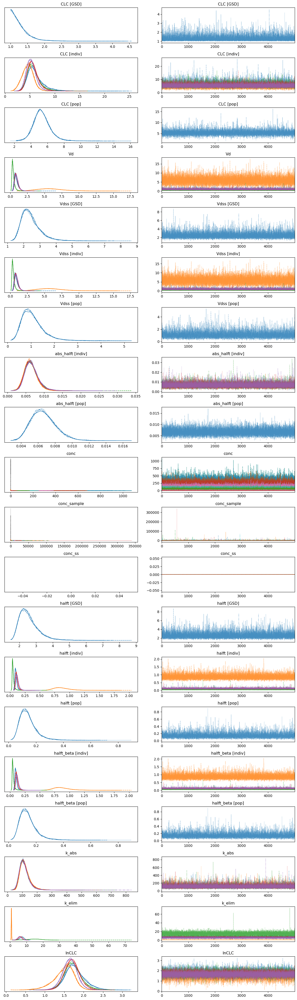

In [47]:
with pfas_female_1cmpt_mouse.model:
    az.plot_trace(pfas_female_1cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


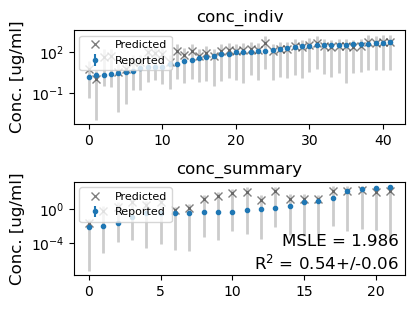

In [48]:
pfas_female_1cmpt_mouse.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [49]:
pfas_female_2cmpt_mouse = PyPKMC(pfas_female_data_mouse, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx', Rkcd_SD_prior = 1,
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior) # 0.1
pfas_female_2cmpt_mouse.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro', random_seed=98765,
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Female_mouse_2cmpt
hierarchical model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (77), generating only 20 plots
  warnings.warn(


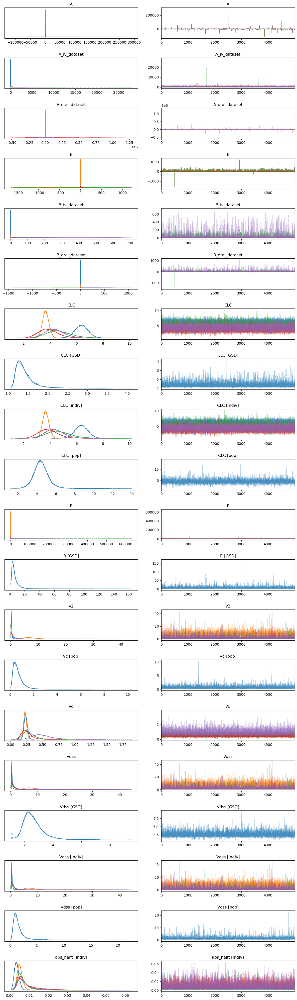

In [50]:
with pfas_female_2cmpt_mouse.model:
    az.plot_trace(pfas_female_2cmpt_mouse._trace)
    plt.tight_layout()

conc_indiv
conc_summary


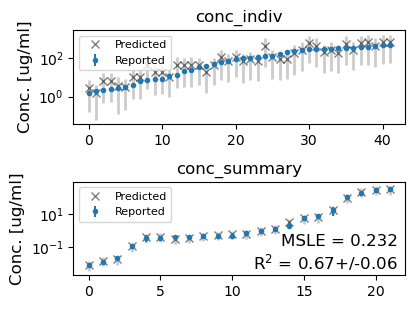

In [51]:
pfas_female_2cmpt_mouse.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-250.952988,23.694564,0.000000,1.0,44.791437,0.000000,True,log
1_compartment,1,-396.650550,18.896800,145.697562,0.0,45.358397,23.272528,True,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

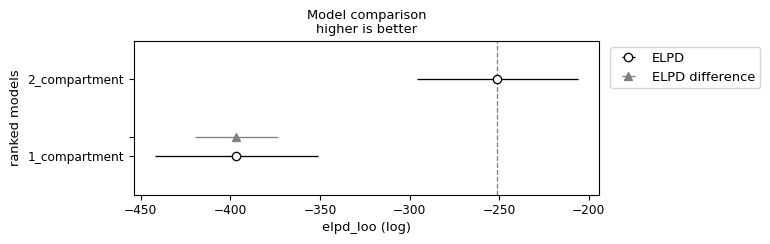

In [52]:
pfas_female_mouse_compare = az.compare({"1_compartment": pfas_female_1cmpt_mouse._trace, "2_compartment": pfas_female_2cmpt_mouse._trace},
                           var_name="combined",ic='loo')
display(pfas_female_mouse_compare)
az.plot_compare(pfas_female_mouse_compare, insample_dev=False)

#### Define winning model

In [53]:
pfas_female_mouse = pfas_female_2cmpt_mouse
print(pfas_female_mouse.N_divergences)
print(f'Pass all metrics = {pfas_female_mouse.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


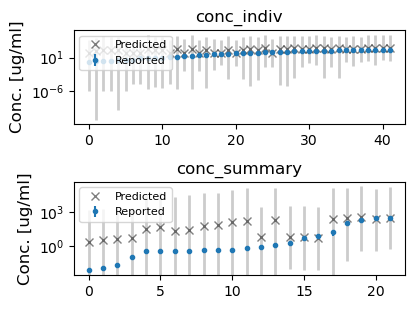

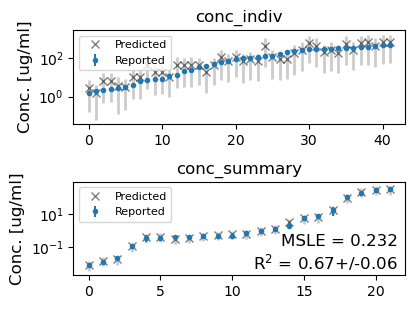

In [54]:
pfas_female_mouse.plot_data_ppc(group='prior', savefig=True)
pfas_female_mouse.plot_data_ppc(group='posterior', savefig=True)

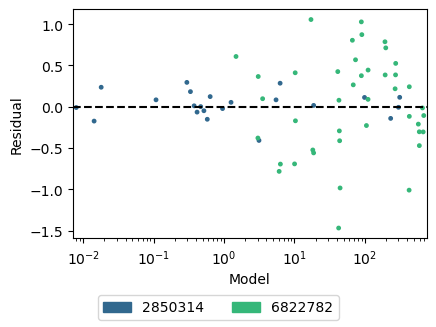

In [55]:
pfas_female_mouse.plot_residuals() 

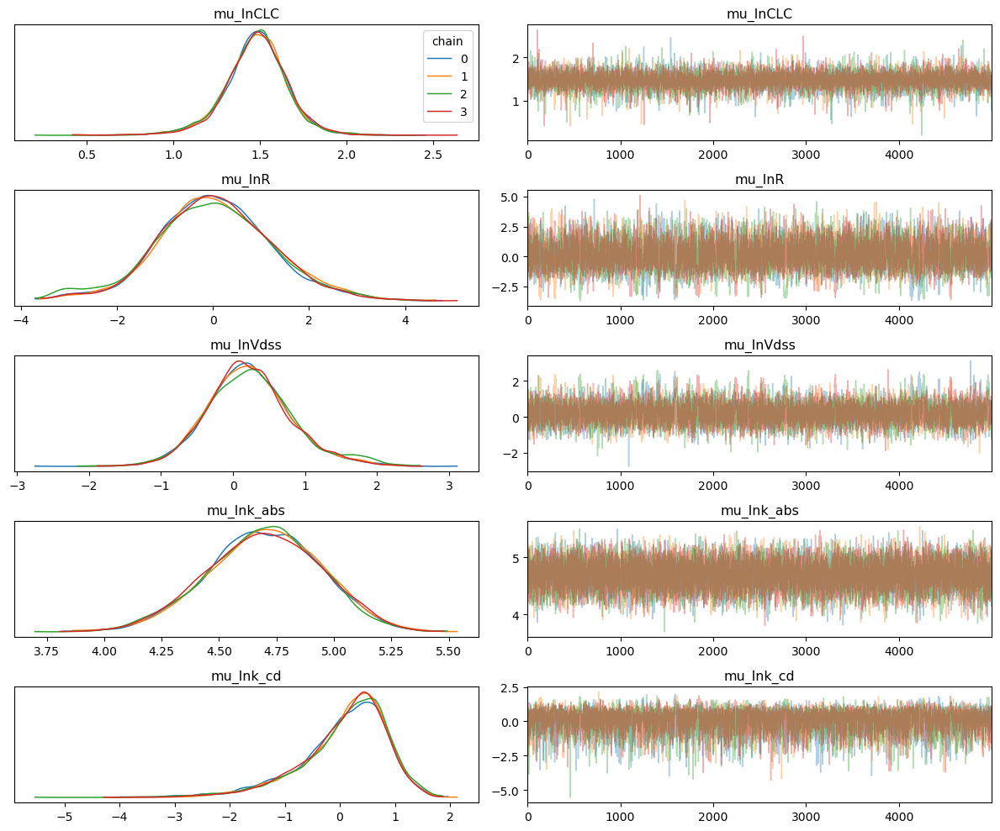

In [56]:
trace_model = pfas_female_mouse
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/mouse/PFHxA/PFHxA_Female_mouse_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


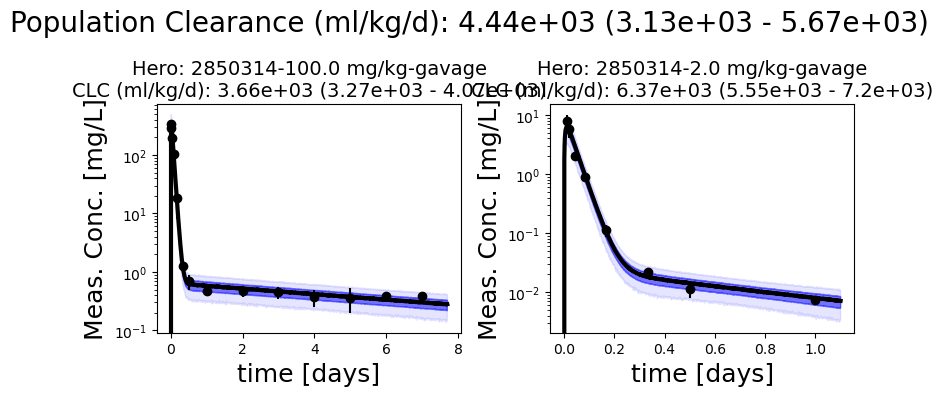

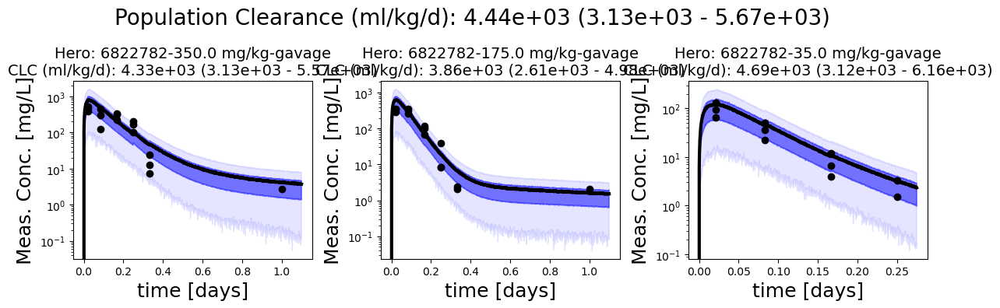

In [57]:
pfas_female_mouse.plot_all_studies()

### PK stats

In [58]:
pfas_female_mouse.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],4.44082,0.81052,3.12853,5.66529
Vc [pop],0.65832,0.44091,0.12808,1.22728
Vdss [pop],1.52544,1.15519,0.30082,2.72363
abs_halft [pop],0.00652,0.00165,0.00391,0.00902
halft [pop],0.25073,0.21919,0.04153,0.45509
halft_alpha [pop],0.07259,0.03727,0.01875,0.12276
halft_beta [pop],1.50742,2.59986,0.05420,3.31792


# Primate

## Male

Because of LoD issues, we fit t < 2 days. On the second day 2 out of 3 were below LoD

In [59]:
%%time
pfas_male_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Male', species='primate')
pfas_male_data_primate.head()
pfas_male_data_primate = pfas_male_data_primate[pfas_male_data_primate.time_cor < 2]

Hero ID available:  [2850314 2850396 3859701 5916078 6822782]
dropping duplicated column
Hero ID used:  [2850396]
CPU times: user 65.7 ms, sys: 3.97 ms, total: 69.7 ms
Wall time: 68.9 ms


### Run the models

#### 1-Compartment model

In [60]:
pfas_male_1cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Male_primate_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


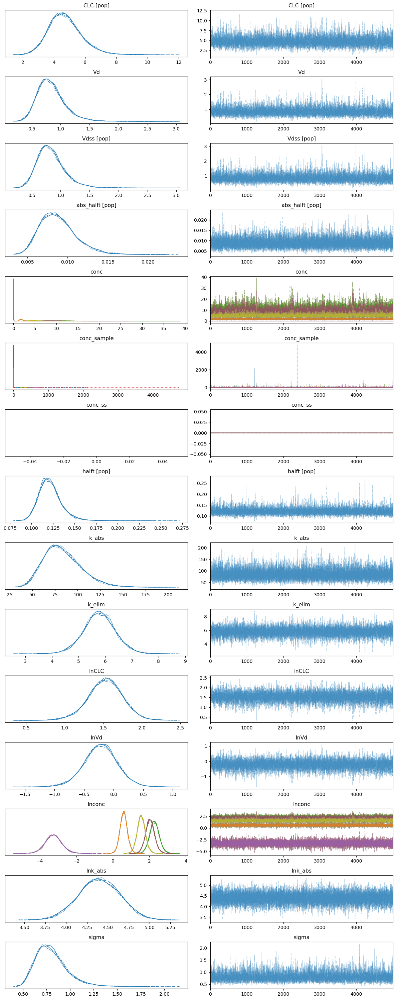

In [61]:
with pfas_male_1cmpt_primate.model:
    az.plot_trace(pfas_male_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


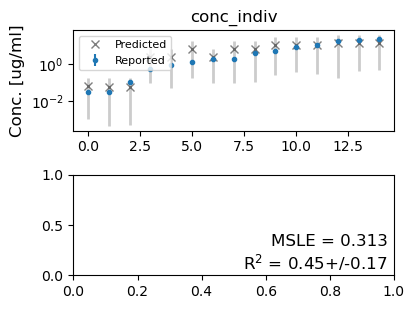

In [62]:
pfas_male_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [63]:
pfas_male_2cmpt_primate = PyPKMC(pfas_male_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_male_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Male_primate_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


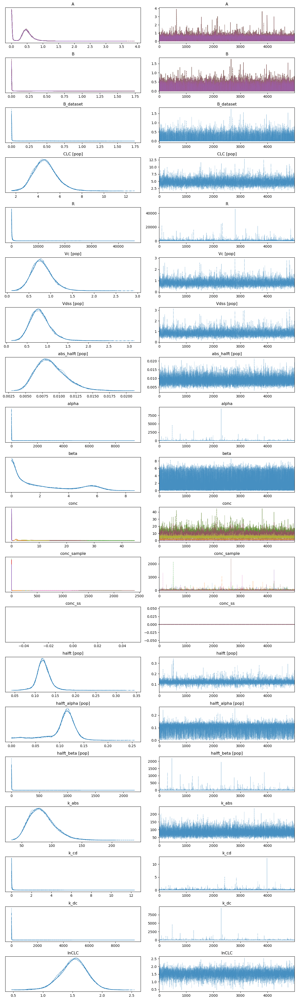

In [64]:
with pfas_male_2cmpt_primate.model:
    az.plot_trace(pfas_male_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


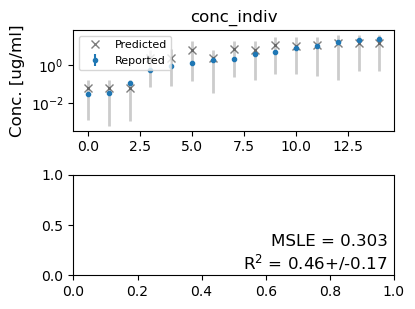

In [65]:
pfas_male_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/stats.py:789: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-27.771953,2.532956,0.000000,1.0,8.176636,0.000000,True,log
1_compartment,1,-27.850381,2.329805,0.078427,0.0,8.222050,0.139793,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

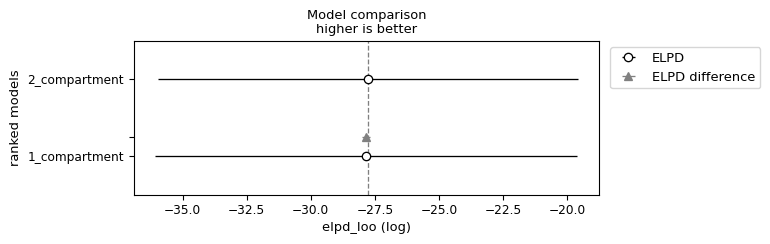

In [66]:
pfas_male_primate_compare = az.compare({"1_compartment": pfas_male_1cmpt_primate._trace, "2_compartment": pfas_male_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_male_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [67]:
pfas_male_primate = pfas_male_2cmpt_primate
print(pfas_male_primate.N_divergences)
print(f'Pass all metrics = {pfas_male_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


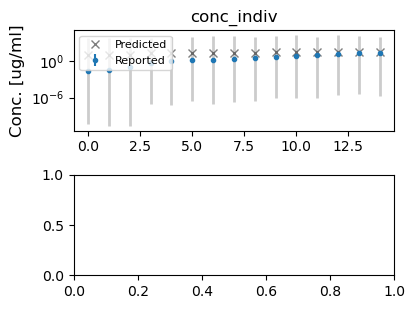

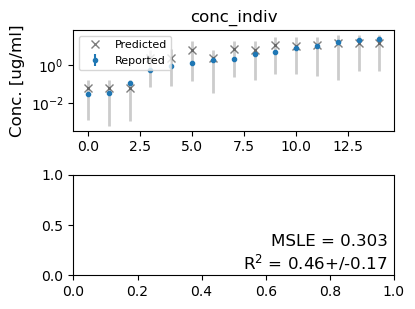

In [68]:
pfas_male_primate.plot_data_ppc(group='prior', savefig=True)
pfas_male_primate.plot_data_ppc(group='posterior', savefig=True)

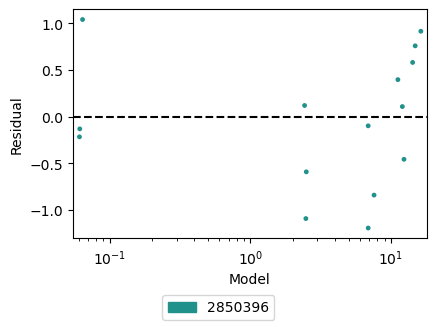

In [69]:
pfas_male_primate.plot_residuals() 

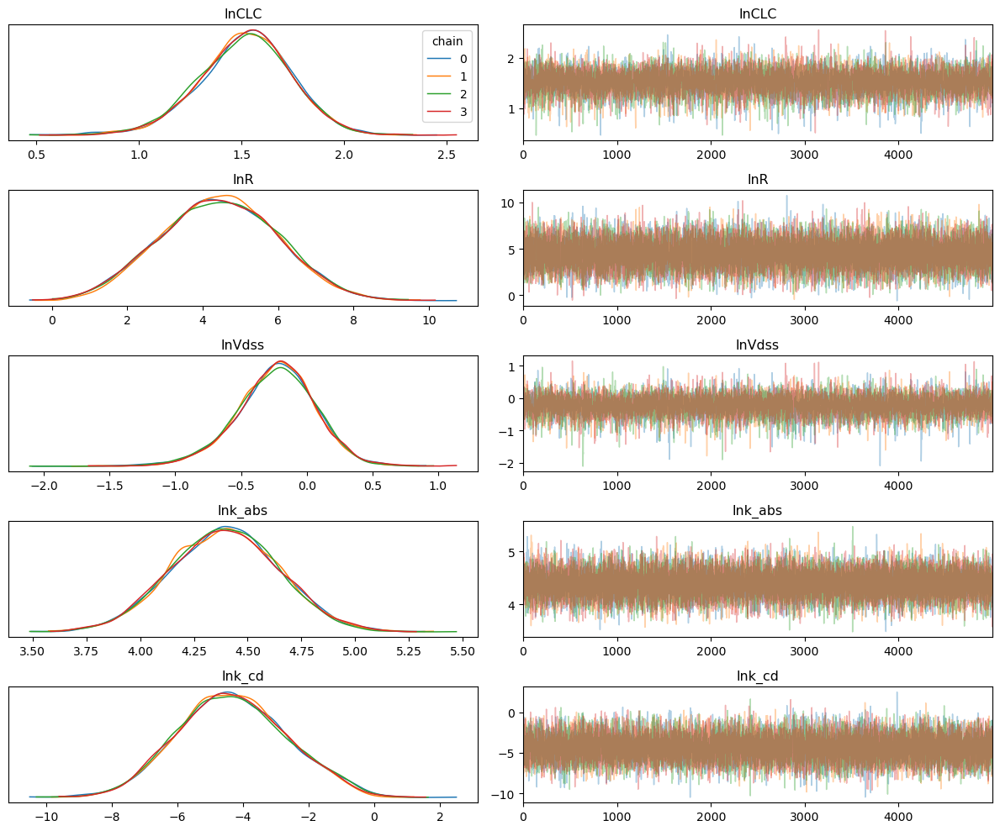

In [70]:
trace_model = pfas_male_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFHxA/PFHxA_Male_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


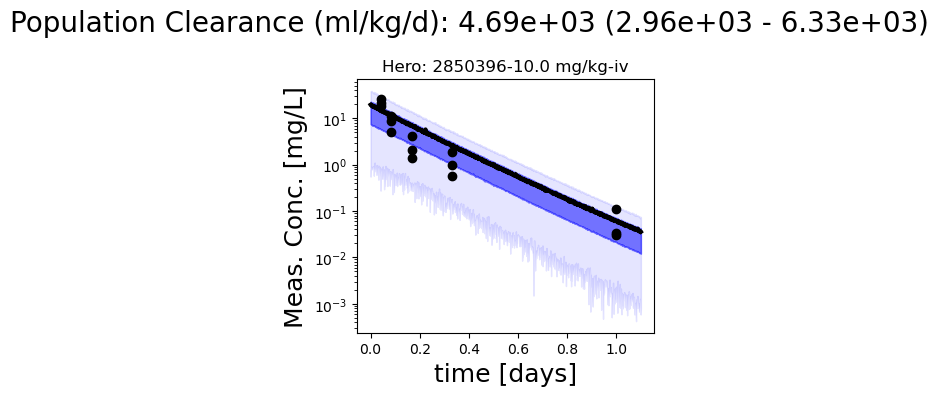

In [71]:
pfas_male_primate.plot_all_studies()

### PK stats

In [72]:
pfas_male_primate.get_pk_stats() # 2cmpt

,mean,sd,hdi_5%,hdi_95%
CLC [pop],4.68603,1.06309,2.96082,6.33211
Vc [pop],0.80086,0.24689,0.41256,1.18550
Vdss [pop],0.82741,0.25588,0.42663,1.20947
abs_halft [pop],0.00882,0.00224,0.00535,0.01237
halft [pop],0.12107,0.01750,0.09474,0.14693
halft_alpha [pop],0.10358,0.03251,0.04143,0.14771
halft_beta [pop],5.05075,35.66733,0.08037,7.81280


## Female

Because of LoD issues, we fit t < 1 day. After first day, 2/3 were bellow LoD.

In [73]:
%%time
pfas_female_data_primate = pfas_tmp.get_processed_data(chemical=chemical, sex='Female', species='primate')
pfas_female_data_primate = pfas_female_data_primate[pfas_female_data_primate.time_cor < 1]
pfas_female_data_primate.head()

Hero ID available:  [2850314 2850396 3859701 5916078 6822782]
dropping duplicated column
Hero ID used:  [2850396]
CPU times: user 66.2 ms, sys: 2.01 ms, total: 68.2 ms
Wall time: 67.4 ms


,hero_id,study_id,animal_id,N_animals,BW,BW_units,BW_init,BW_init_units,species,strain,dose,dose_units,time,time_units,conc_mean,conc_sd,standard_error,conc_units,route,matrix,sex,dtxsid,source,initial_age,initial_age_units,initial_weight,initial_weight_units,n,author,preferred_name,pfas_abbrev,casrn,iupac_name,mapped_dtxsid,n_times,idx1,idx2,idx3,time_cor,dose_cor,BW_cor,conc_mean_cor,conc_sd_cor,Dss,lod,censored,route_idx,sex_idx,lnconc_sd,lnconc_mean,cv,aidx,dose_mg,dataset_str
0,2850396,42,1572,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,1.0,hour,25140.0,0.0,0,ng/ml,iv,serum,Female,DTXSID3031862,Table 1,3.0,years,2.5,kilograms,1,Chengelis,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,6,0,0,0,0.041667,10.0,2.5,25.140,0.0,0.0,-1,0,0,1,0.0,3.224460,0.0,True,25.0,2850396-10.0 mg/kg-iv
1,2850396,42,1573,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,1.0,hour,17469.0,0.0,0,ng/ml,iv,serum,Female,DTXSID3031862,Table 1,3.0,years,2.5,kilograms,1,Chengelis,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,6,0,0,0,0.041667,10.0,2.5,17.469,0.0,0.0,-1,0,0,1,0.0,2.860428,0.0,True,25.0,2850396-10.0 mg/kg-iv
2,2850396,42,1576,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,1.0,hour,20004.0,0.0,0,ng/ml,iv,serum,Female,DTXSID3031862,Table 1,3.0,years,2.5,kilograms,1,Chengelis,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,6,0,0,0,0.041667,10.0,2.5,20.004,0.0,0.0,-1,0,0,1,0.0,2.995932,0.0,True,25.0,2850396-10.0 mg/kg-iv
3,2850396,42,1572,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,7447.0,0.0,0,ng/ml,iv,serum,Female,DTXSID3031862,Table 1,3.0,years,2.5,kilograms,1,Chengelis,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,6,0,0,0,0.083333,10.0,2.5,7.447,0.0,0.0,-1,0,0,1,0.0,2.007811,0.0,True,25.0,2850396-10.0 mg/kg-iv
4,2850396,42,1573,1,-1.0,NaN,2.5,NaN,primate,cynomolgus,10.0,mg/kg,2.0,hour,5086.0,0.0,0,ng/ml,iv,serum,Female,DTXSID3031862,Table 1,3.0,years,2.5,kilograms,1,Chengelis,Perfluorohexanoic acid,PFHxA,307-24-4,"2,2,3,3,4,4,5,5,6,6,6-undecafluorohexanoic acid",DTXSID3031862,6,0,0,0,0.083333,10.0,2.5,5.086,0.0,0.0,-1,0,0,1,0.0,1.626492,0.0,True,25.0,2850396-10.0 mg/kg-iv


### Run the models

#### 1-Compartment model

In [74]:
pfas_female_1cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_1cmpt_primate.sample(model_type='1-compartment', target_accept=0.90, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Female_primate_1cmpt
single level model, 1-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


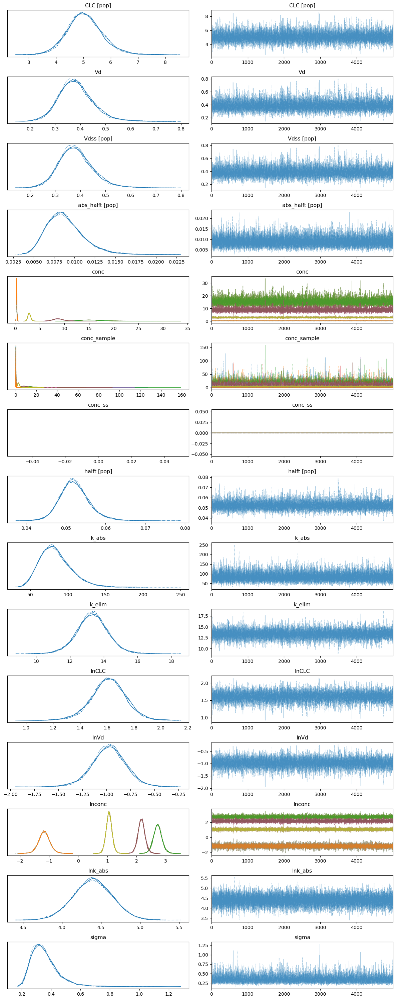

In [75]:
with pfas_female_1cmpt_primate.model:
    az.plot_trace(pfas_female_1cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


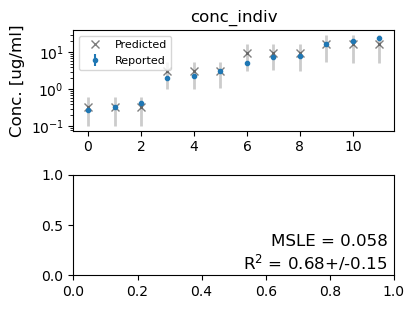

In [76]:
pfas_female_1cmpt_primate.plot_data_ppc(group='posterior')

#### 2-Compartment model

In [77]:
pfas_female_2cmpt_primate = PyPKMC(pfas_female_data_primate, time_label='time_cor', y_obs_label='conc_mean_cor', sd_obs_label='conc_sd_cor',
                         route_label='route_idx', dose_label='dose_mg', BW_label='BW_cor', 
                         study_label='hero_id', dataset_label='dataset_str', indiv_label='aidx',
                         CLC_prior = CLC_prior, Vdss_prior = Vdss_prior)
pfas_female_2cmpt_primate.sample(model_type='2-compartment', target_accept=0.99, nuts_sampler='numpyro',
                             load_trace=load_trace, tune=10000, draws=5000, likelihood='Lognormal', sample_prior=True, sample_posterior=True)

PFHxA_Female_primate_2cmpt
single level model, 2-compartment
Checking metrics...
Pass all metrics = True
Assign pareto...


/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/plots/traceplot.py:223: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (26), generating only 20 plots
  warnings.warn(
/data/tzurlind/pkgs/miniforge3/lib/python3.12/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


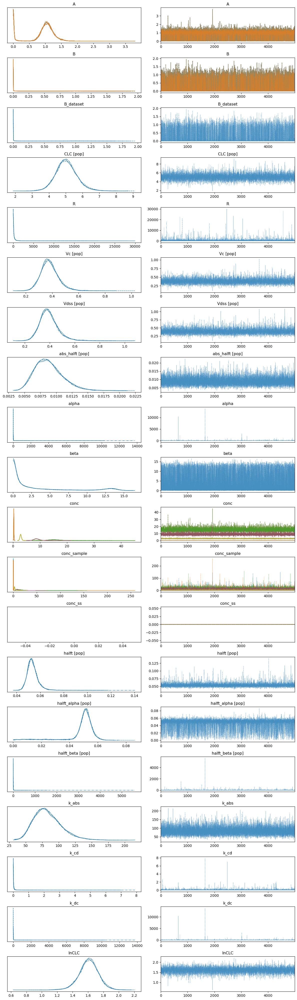

In [78]:
with pfas_female_2cmpt_primate.model:
    az.plot_trace(pfas_female_2cmpt_primate._trace)
    plt.tight_layout()

conc_indiv
conc_summary


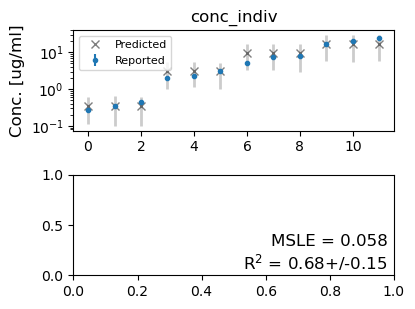

In [79]:
pfas_female_2cmpt_primate.plot_data_ppc(group='posterior')

#### Compare models

,rank,elpd_loo,p_loo,elpd_diff,weight,se,dse,warning,scale
2_compartment,0,-19.501039,2.391826,0.000000,1.0,5.953528,0.000000,False,log
1_compartment,1,-19.572921,2.370457,0.071882,0.0,5.937310,0.056704,False,log


<Axes: title={'center': 'Model comparison\nhigher is better'}, xlabel='elpd_loo (log)', ylabel='ranked models'>

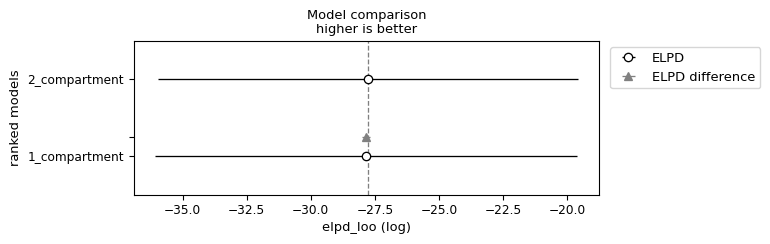

In [80]:
pfas_female_primate_compare = az.compare({"1_compartment": pfas_female_1cmpt_primate._trace, "2_compartment": pfas_female_2cmpt_primate._trace},
                           var_name="combined",ic='loo')
display(pfas_female_primate_compare)
az.plot_compare(pfas_male_primate_compare, insample_dev=False)

#### Define winning model

In [81]:
pfas_female_primate = pfas_female_2cmpt_primate
print(pfas_female_primate.N_divergences)
print(f'Pass all metrics = {pfas_female_primate.pass_all_metrics}')

0
Pass all metrics = True


### Posterior predictive check on winning model

conc_indiv
conc_summary
conc_indiv
conc_summary


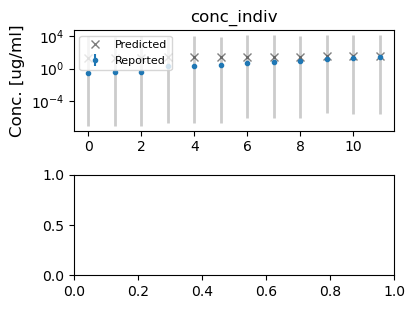

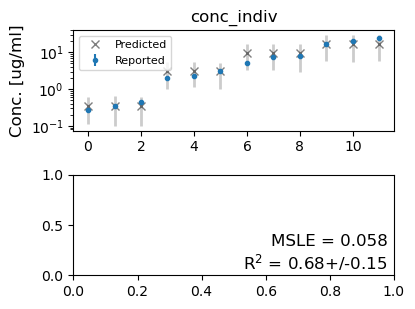

In [82]:
pfas_female_primate.plot_data_ppc(group='prior', savefig=True)
pfas_female_primate.plot_data_ppc(group='posterior', savefig=True)

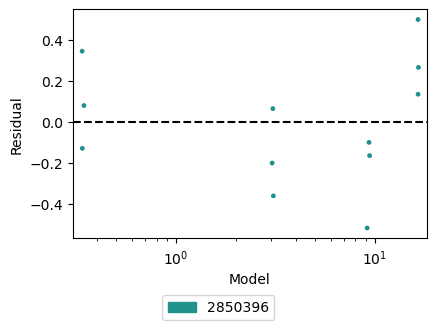

In [83]:
pfas_female_primate.plot_residuals() 

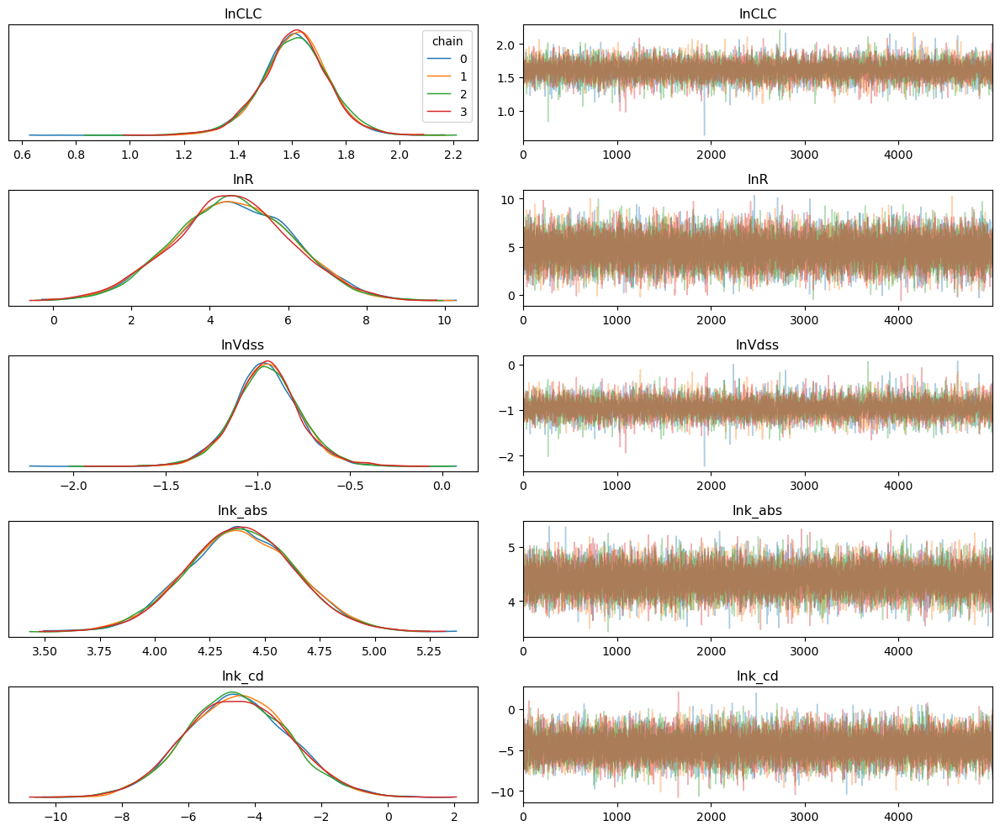

In [84]:
trace_model = pfas_female_primate
with trace_model.model:
    if trace_model.model_structure == 'hierarchical':
        az.plot_trace(trace_model._trace, var_names=['^mu_ln'], filter_vars='regex', compact=False, legend=True)
    else:
        az.plot_trace(trace_model._trace, var_names=['^ln(?!conc).*$'], filter_vars='regex', compact=False, legend=True)
    plt.tight_layout()
    plt.savefig('../ppc/traceplots/%s_%s_%s_traceplot.png'% (trace_model.chemical, trace_model.species, trace_model.sex))

../species_fits/primate/PFHxA/PFHxA_Female_primate_CLC_2cmpt.pdf
Running PPC...
setting params...
sampling...


Sampling: [conc_sample]


Output()

Calculating stats...


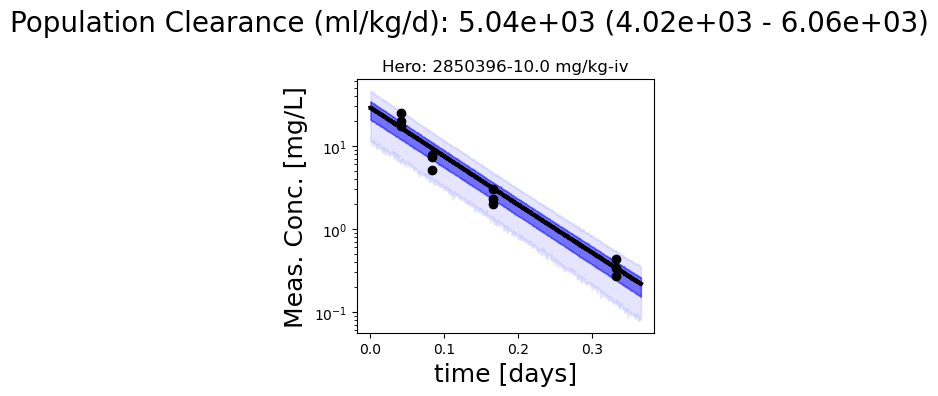

In [85]:
pfas_female_primate.plot_all_studies()

### PK stats

In [86]:
pfas_female_primate.get_pk_stats()

,mean,sd,hdi_5%,hdi_95%
CLC [pop],5.04216,0.63143,4.02448,6.05782
Vc [pop],0.38090,0.06777,0.26930,0.48501
Vdss [pop],0.39260,0.07453,0.27246,0.50417
abs_halft [pop],0.00885,0.00223,0.00534,0.01229
halft [pop],0.05370,0.00537,0.04622,0.06055
halft_alpha [pop],0.04871,0.01072,0.03840,0.06279
halft_beta [pop],6.46687,50.10812,0.04196,10.24924
